In [3]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Coral Production
Coral production as a function of depth, taken from *Bosscher and Schlager (1992)*.
They use the following function for growth:
$$
G=G_m \tanh(I_o e^{-kz}/I_k)
$$
Where $G_m$ is the maximum growth rate, on the order of 0.010-0.015 m y$^{-1}$

$k$ is the extinction coefficient, on the order of $0.04-0.16$ m$^{-1}$

$I_o$ is the surface light intensity, which in the tropics, is on the order of 2000-2240 $\mu$ E m$^{-2}$s$^{-1}$

$I_k$ is the saturation light intensity, which ranges from $50-450$ $\mu$ E m$^{-2}$s$^{-1}$

Below is this function encoded, adapted to be given elevations relative to sea level

Text(0.5, 1.0, 'Coral Production Rates')

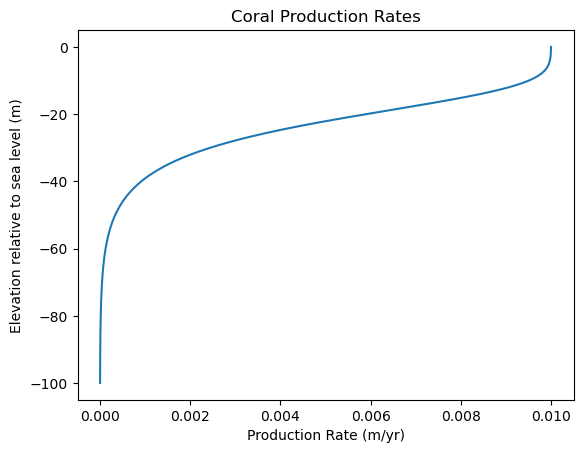

In [4]:
def coral_production(z, max_growth=0.01, extinction_coeff=0.1, surface_light_intensity=2000, 
                     saturation_light_intensity=400):
    return max_growth*np.tanh((surface_light_intensity*np.exp(-extinction_coeff*-z))/saturation_light_intensity)

coral_rate_plot_z = np.arange(0,-100,-.1)
production_rate = coral_production(coral_rate_plot_z)
fig, ax = plt.subplots() 
ax.plot(production_rate, coral_rate_plot_z)
ax.set_xlabel("Production Rate (m/yr)")
ax.set_ylabel("Elevation relative to sea level (m)")
ax.set_title("Coral Production Rates")
    

Here is some plotting code for making nice plots later

In [5]:
def make_coral_plot(ax, base_surface, coral_heights, x_values, sea_level, y_min, y_max):
    ax.plot(x_values, base_surface)
    ax.plot(x_values, base_surface+coral_heights,'r')
    ax.axhline(y=sea_level, color='b', linestyle='--')
    ax.set_xlabel("Distance from Modern Coastline (m)")
    ax.set_ylabel("Depth Relative to Modern Sea Level (m)")
    ax.set_ylim(y_min, y_max)

def make_height_plot(ax, x_values, heights, y_min, y_max):
    if len(heights)<50:
        marker = 'o'
    else:
        marker = '-'
    ax.plot(x_values, heights, marker)
    ax.set_xlabel("Distance from Modern Coastline (m)")
    ax.set_ylabel("Height of Corals")
    ax.set_ylim(y_min, y_max)

def make_sea_level_time_plot(ax, time, sea_level, position):
    ax.plot(time, sea_level)
    ax.plot(time[position], sea_level[position], 'ro')

def make_growth_plot(ax, x_values, growths, y_min, y_max):
    if len(growths)<50:
        marker = 'o'
    else:
        marker = '-'
    ax.plot(x_values, growths, marker)
    ax.set_xlabel("Distance from Modern Coastline (m)")
    ax.set_ylabel("Growth Rate of Corals (m)")
    ax.set_ylim(y_min, y_max)

def make_advanced_coral_plot(axs, base_surface, coral_heights, coral_growth, x_values, sea_levels, 
                             times, position, plate_y_min, plate_y_max, height_y_min, height_y_max,
                             growth_y_min, growth_ymax, x_min, x_max):
    sea_plot = axs[0]
    plate_plot = axs[1]
    height_plot = axs[2]
    growth_rate_plot = axs[3]
    make_coral_plot(plate_plot, base_surface, coral_heights, x_values, sea_levels[position], 
                    plate_y_min, plate_y_max)
    make_height_plot(height_plot, x_values, coral_heights, height_y_min, height_y_max)
    make_sea_level_time_plot(sea_plot, times, sea_levels, position)
    make_growth_plot(growth_rate_plot, x_values, coral_growth, growth_y_min, growth_y_max)
    for ax in axs[1:]:
        ax.set_xlim(x_min,x_max)

# A simple model

We use a simple 1D model where for each cell we keep track of:
- Base elevation (relative to modern sea level)
- coral growth (initialized at zero)
- x position (static and mostly used for plotting)
  
We also keep track of sea level for model time (relative to modern sea level)
We also allow for the parameters of the coral production curve to vary with time

In [6]:
class coral_model:
    def __init__(self, x_values, z_values, dx, sea_level, max_growth=0.01, 
                 extinction_coeff=0.1, surface_light_intensity=2000, 
                 saturation_light_intensity=400, lowering_rate = lambda z: 0):
        self.x_values = x_values
        self.z_values = z_values
        self.dx = dx
        self.sea_level=sea_level
        self.max_growth = max_growth
        self.extinction_coeff = extinction_coeff
        self.surface_light_intensity = surface_light_intensity
        self.saturation_light_intensity = saturation_light_intensity
        self.lowering_rate = lowering_rate
        self.coral_height = np.zeros(self.z_values.shape)
        self.growth_rate = np.zeros(self.z_values.shape)

    def run_timestep(self,dt):
        #self.z_values += self.lowering_rate(self.z_values)
        effective_depth = self.z_values+self.coral_height-self.sea_level
        growth_rate = np.where(effective_depth<0,
                               self.max_growth*np.tanh((self.surface_light_intensity*np.exp(-self.extinction_coeff*-effective_depth))/self.saturation_light_intensity),
                               0)
        growth_rate =np.where(growth_rate>=np.abs(effective_depth),effective_depth,growth_rate)
        self.growth_rate = growth_rate
        self.coral_height += growth_rate*dt

Now we initialize our model

In [7]:
dx = 10
end_of_plate = 1000
range_inland = -200
distances = np.arange(range_inland, end_of_plate, dx)
depths = -.05*distances

and run it

In [8]:
model=coral_model(distances, depths, dx, 0)
time_range = 10000
dt = 10
timesteps = np.arange(0,time_range, dt)
initial_plate = model.z_values.copy()
profiles = []
coral_profiles = []
seas = []
for i, t in enumerate(timesteps):
    model.run_timestep(dt)
    if t%100==0:
        profiles.append(model.z_values.copy())
        coral_profiles.append(model.coral_height.copy())
        seas.append(model.sea_level)

and animate it

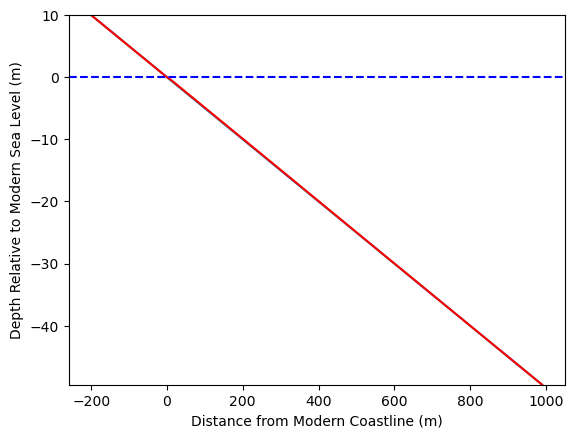

In [9]:
fig, ax = plt.subplots()

total_heights=np.array(profiles)+np.array(coral_profiles)
min_y = np.array(profiles).min()
max_y = total_heights.max()
# 2. define a function to update the plot
def plot_plate(i, y_min, y_max):
    ax.cla()
    make_coral_plot(ax, profiles[i], coral_profiles[i], model.x_values, seas[i], y_min, y_max)

# 3. Call FuncAnimation
anim = FuncAnimation(fig, lambda i: plot_plate(i, min_y, max_y), len(profiles))
vid = HTML(anim.to_jshtml())
vid

Now, lets move sea level sinuousodially

In [11]:
dx = 100
end_of_plate = 1000
range_inland = -200
distances = np.arange(range_inland, end_of_plate, dx)
depths = -.05*distances
time_range = 10000
dt = 10
timesteps = np.arange(0,time_range, dt)
sea_level_range = 100
sea_level_period = 10000
sea_level = np.sin((2*np.pi*timesteps)/sea_level_period)*sea_level_range
initial_plate = model.z_values.copy()
profiles = []
coral_profiles = []
seas = []
model=coral_model(distances, depths, dx, 0)
for i, t in enumerate(timesteps):
    model.run_timestep(dt)
    model.sea_level=sea_level[i]
    if t%100==0:
        profiles.append(model.z_values.copy())
        coral_profiles.append(model.coral_height.copy())
        seas.append(model.sea_level)

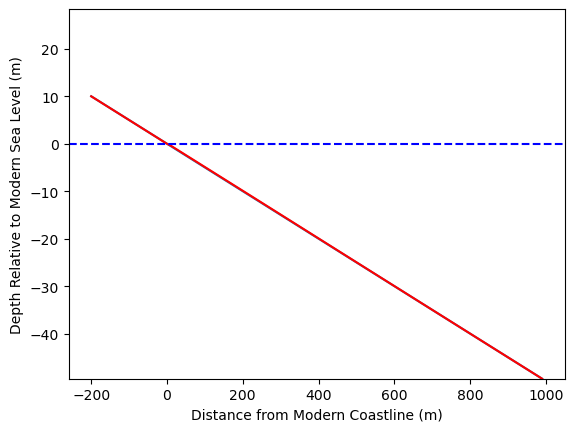

In [12]:
fig, ax = plt.subplots()

total_heights=np.array(profiles)+np.array(coral_profiles)
min_y = np.array(profiles).min()
max_y = total_heights.max()
# 2. define a function to update the plot
def plot_plate(i, y_min, y_max):
    ax.cla()
    make_coral_plot(ax, profiles[i], coral_profiles[i], model.x_values, seas[i], y_min, y_max)

# 3. Call FuncAnimation
anim = FuncAnimation(fig, lambda i: plot_plate(i, min_y, max_y+10), len(profiles))
vid = HTML(anim.to_jshtml())
vid

now, let's subduct the plate starting with 1cm per year

In [39]:
dx = 10
end_of_plate = 200
range_inland = -10000
distances = np.arange(range_inland, end_of_plate, dx)
depths = -.5*distances
time_range = 800000
dt = 10
timesteps = np.arange(0,time_range, dt)
lowering_rate = 0.01
sea_level_range = 100
sea_level_period = 100000
sea_level = -np.sin((2*np.pi*timesteps)/sea_level_period)*sea_level_range
initial_plate = model.z_values.copy()
profiles = []
coral_profiles = []
seas = []
growth_rates = []
model=coral_model(distances, depths, dx, 0)
for i, t in enumerate(timesteps):
    model.run_timestep(dt)
    model.sea_level=sea_level[i]
    model.z_values -= lowering_rate*dt
    if t%10000==0:
        profiles.append(model.z_values.copy())
        coral_profiles.append(model.coral_height.copy())
        seas.append(model.sea_level)
        growth_rates.append(model.growth_rate)

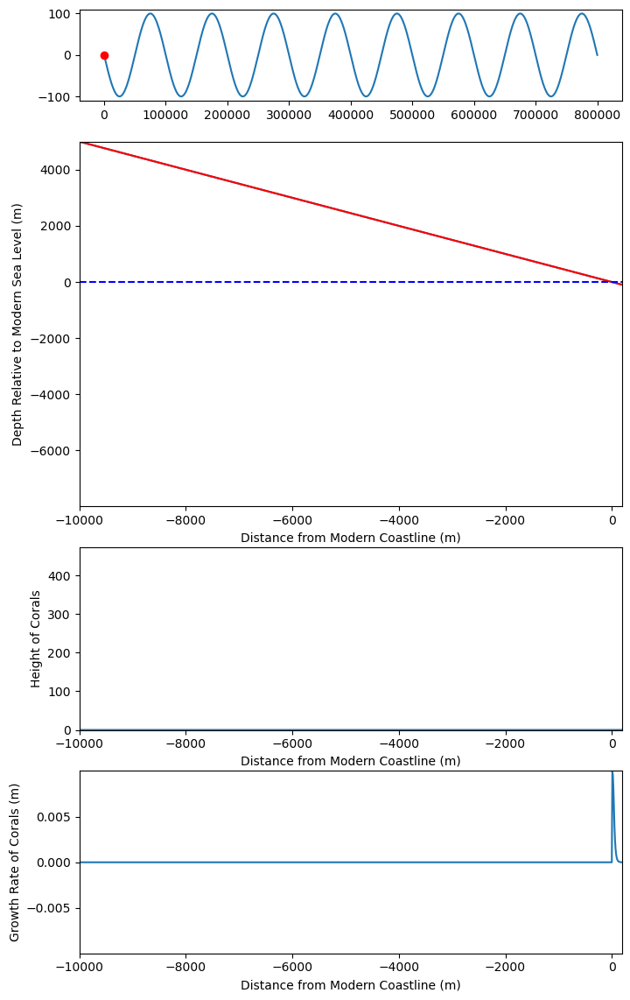

In [40]:
fig, axs = plt.subplots(4, height_ratios=(0.1, 0.4, 0.2, 0.2), figsize=(8,14))
total_heights=np.array(profiles)+np.array(coral_profiles)
plate_y_min = np.array(profiles).min()
plate_y_max = total_heights.max()
height_y_min = np.array(coral_profiles).min()
height_y_max = np.array(coral_profiles).max()
growth_y_min = np.array(growth_rates).min()
growth_y_max = np.array(growth_rates).max()
x_min = model.x_values.min()#-80
x_max = model.x_values.max()#-70
# 2. define a function to update the plot
def plot_plate(i):
    [ax.cla() for i, ax in np.ndenumerate(axs) ]
    make_advanced_coral_plot(axs, profiles[i], coral_profiles[i], growth_rates[i], model.x_values, 
                             sea_level, timesteps, i*1000, plate_y_min, plate_y_max, height_y_min,
                             height_y_max, growth_y_min, growth_y_max, x_min, x_max)
    #make_coral_plot(ax, profiles[i], coral_profiles[i], model.x_values, seas[i], y_min, y_max)

# 3. Call FuncAnimation
anim = FuncAnimation(fig, plot_plate, len(profiles))
vid = HTML(anim.to_jshtml())
vid

boooring.  Lets look at uplift.

In [43]:
dx = 10
end_of_plate = 10000
range_inland = -200
distances = np.arange(range_inland, end_of_plate, dx)
depths = -.5*distances
time_range = 800000
dt = 10
timesteps = np.arange(0,time_range, dt)
lowering_rate = -0.01
sea_level_range = 100
sea_level_period = 100000
sea_level = -np.sin((2*np.pi*timesteps)/sea_level_period)*sea_level_range
initial_plate = model.z_values.copy()
profiles = []
coral_profiles = []
seas = []
growth_rates = []
model=coral_model(distances, depths, dx, 0)
for i, t in enumerate(timesteps):
    model.run_timestep(dt)
    model.sea_level=sea_level[i]
    model.z_values -= lowering_rate*dt
    if t%10000==0:
        profiles.append(model.z_values.copy())
        coral_profiles.append(model.coral_height.copy())
        seas.append(model.sea_level)
        growth_rates.append(model.growth_rate)

/tmp/ipykernel_35601/2312031302.py:21: RuntimeWarning: overflow encountered in multiply
  self.max_growth*np.tanh((self.surface_light_intensity*np.exp(-self.extinction_coeff*-effective_depth))/self.saturation_light_intensity),
/tmp/ipykernel_35601/2312031302.py:21: RuntimeWarning: overflow encountered in exp
  self.max_growth*np.tanh((self.surface_light_intensity*np.exp(-self.extinction_coeff*-effective_depth))/self.saturation_light_intensity),


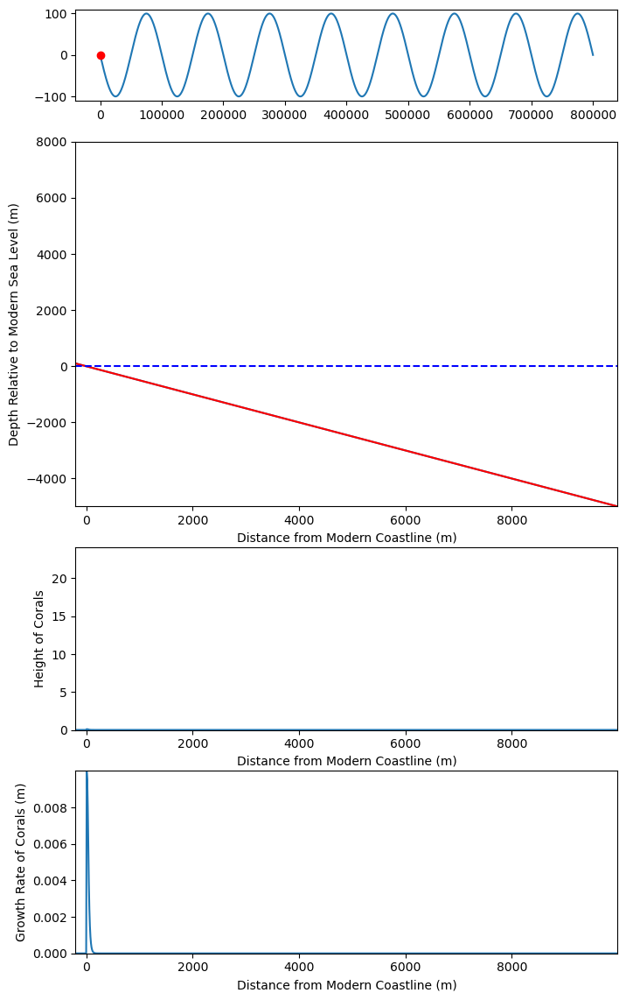

In [44]:
fig, axs = plt.subplots(4, height_ratios=(0.1, 0.4, 0.2, 0.2), figsize=(8,14))
total_heights=np.array(profiles)+np.array(coral_profiles)
plate_y_min = np.array(profiles).min()
plate_y_max = total_heights.max()
height_y_min = np.array(coral_profiles).min()
height_y_max = np.array(coral_profiles).max()
growth_y_min = np.array(growth_rates).min()
growth_y_max = np.array(growth_rates).max()
x_min = model.x_values.min()#-80
x_max = model.x_values.max()#-70
# 2. define a function to update the plot
def plot_plate(i):
    [ax.cla() for i, ax in np.ndenumerate(axs) ]
    make_advanced_coral_plot(axs, profiles[i], coral_profiles[i], growth_rates[i], model.x_values, 
                             sea_level, timesteps, i*1000, plate_y_min, plate_y_max, height_y_min,
                             height_y_max, growth_y_min, growth_y_max, x_min, x_max)
    #make_coral_plot(ax, profiles[i], coral_profiles[i], model.x_values, seas[i], y_min, y_max)

# 3. Call FuncAnimation
anim = FuncAnimation(fig, plot_plate, len(profiles))
vid = HTML(anim.to_jshtml())
vid

Wait, something interesing!  The only thing that's change in this example is if the plate is going up or going down, not the rate or anything else, but we have very different profiles!
## Subduction
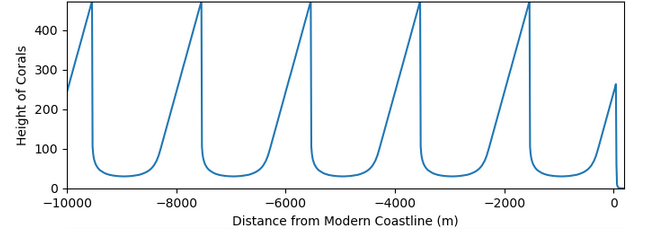
## Uplift
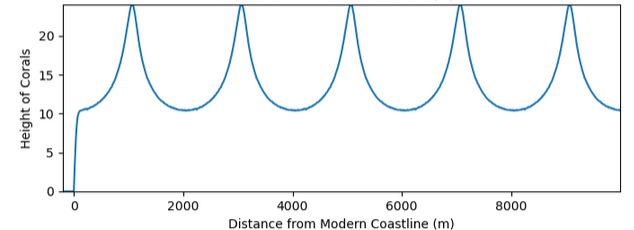

Interesting... Lets try to think about how our different functions work together.  Mostly this should be related to our growth rate function:

$$
G=G_m \tanh((I_o e^{-kz})/I_k)
$$

which is a function of $z$ or depth below sea level.  However, we have determined this as a function of $x$ and $t$.  Before we consider our oscilating sea level, we have defined our plate such that $z=-0.5x$, and so
$$
G=G_m \tanh((I_o e^{k(0.5x)})/I_k)
$$
of course, we add in our sinuous sea level:

$$
G=G_m \tanh((I_o e^{k(0.5x-100\sin(\frac{2\pi t}{P})})/I_k)
$$
Where $t$ is our time, and $P$ is the period of osciallation (100,000 years in the above models).  

Great, I think this should be our formula for growth rate!  So while I would like to be able to sum it up, there's one more issue.  The past growth rate changes the elevation of the coral growth surface relative to sea level.  Lets call the function of coral heights $C(t)$.  And so now we have:

$$
G(x,t)=G_m \tanh((I_o e^{k(0.5x-100\sin(\frac{2\pi t}{P})+C(t-1)})/I_k)
$$

And

$$
C(x,t)=\sum_{i=1}^{t-1} G(x,i)
$$

We're getting close to an analytic solution...right?